#### TEMITAYO ADE-OSHIFOGUN | BRAINSTATION | DATA SCIENCE BOOTCAMP FEB 2021 - MAY 2021

Capstone Project: Twitter Sentiment Analysis on Dogecoin. This project aims to answer or add clarity to the question, "Can we predict the price movement of Dogecoin using tweets?"

# Table of Contents
1. [Data Collection & EDA](#DataCollection)
    1. [Gather Twitter Data](#gather)
    2. [Feature Engineering](#feature)
2. [Data Cleansing](#clean)
3. [Merge Datasets](#merge)
    1. [Doge Price Dataset Feature Engineering](#dpdfe)
    2. [Merge Tweets dataset & Price dataset](#bigmerge)
4. [Sampled Dataset Model Analysis](#sampled)
    1. [Top 20 Words by Sentiment (Sampled dataset)](#top20sampled)
5. [Full Dataset Model Analysis](#full)
    1. [Top 20 Words by Sentiment (Full dataset)](#top20full)
    2. [Further Model Scores](#further)

In [2]:
### Import neccesary packages 

import pandas as pd
pd.set_option('display.max_colwidth', 0) #To display entire text content of a column
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os
import pickle
import joblib as joblib
import twint 
import nest_asyncio
import spacy
import re
from functools import reduce
import sys
import datetime as dt
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import train_test_split
from nltk.corpus import stopwords
import nltk

In [3]:
from sklearn.linear_model import LogisticRegression

%matplotlib inline

<a name="DataCollection"></a>
# Gather Twitter data using "$DOGE" cashtag
1. Pull Tweets
2. Store to CSV
3. Feature Engineering



<a name="gather"></a>

In [ ]:
### Step 1. Pull tweets using Twint

nest_asyncio.apply()
c = twint.Config()
c.Search = "$doge"
#c.Min_retweets = 25
#c.Filter_retweets = True
c.Since = '2021-01-20'
c.Until = '2021-05-06'
#c.Limit = 100000
c.Pandas = True 
twint.run.Search(c)
dogetweets = twint.storage.panda.Tweets_df

1389731565278740480 2021-05-04 18:59:59 -0500 <cryptoexp32562D> $DOGE 600%+ PROFIT😍✅🚀  Checkout the link in bio for crypto signals  $DCR $RCN $BRD #DOGECOIN #bitcoin $BCPT $GXS $NXS $APPC 42061  https://t.co/IwAymI8dQl
1389731530684182530 2021-05-04 18:59:51 -0500 <dogecoinowner> last person to like this tweet gets $10,000 in $DOGE
1389731525193871364 2021-05-04 18:59:50 -0500 <professorkev> @DogecoinRise  $DOGE gotta wonder if Snoop or Cuban sold??
1389731521356042242 2021-05-04 18:59:49 -0500 <badsounds2> Did you miss $DOGE gains? Well... check @elongateog #HODL #dogecoin #Dogecoinarmy #elongate #ELONGATE4CHARITY
1389731500782989316 2021-05-04 18:59:44 -0500 <dylanmpohl> Just trying to fw the ratio $doge  https://t.co/cXDrhHPgdk
1389731499428040704 2021-05-04 18:59:44 -0500 <Hipsey_Nussle> What’s the plan after $Doge gets to a $1?
1389731466200895489 2021-05-04 18:59:36 -0500 <MattSDuncan> $doge is on such a HUGE pump now. To the moon I guess 🚀
1389731448840671234 2021-05-04 18:59:32

In [5]:
dogetweets.shape

(914460, 38)

In [6]:
dogetweets

,id,conversation_id,created_at,date,timezone,place,tweet,language,hashtags,cashtags,...,geo,source,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest
0,1389731565278740480,1389731565278740480,1.620173e+12,2021-05-04 18:59:59,-0500,,$DOGE 600%+ PROFIT😍✅🚀 Checkout the link in bio for crypto signals $DCR $RCN $BRD #DOGECOIN #bitcoin $BCPT $GXS $NXS $APPC 42061 https://t.co/IwAymI8dQl,en,"[dogecoin, bitcoin]","[doge, dcr, rcn, brd, bcpt, gxs, nxs, appc]",...,,,,,,[],,,,
1,1389731530684182530,1389731530684182530,1.620173e+12,2021-05-04 18:59:51,-0500,,"last person to like this tweet gets $10,000 in $DOGE",en,[],[doge],...,,,,,,[],,,,
2,1389731525193871364,1389731525193871364,1.620173e+12,2021-05-04 18:59:50,-0500,,@DogecoinRise $DOGE gotta wonder if Snoop or Cuban sold??,en,[],[doge],...,,,,,,[],,,,
3,1389731521356042242,1389731521356042242,1.620173e+12,2021-05-04 18:59:49,-0500,,Did you miss $DOGE gains? Well... check @elongateog #HODL #dogecoin #Dogecoinarmy #elongate #ELONGATE4CHARITY,en,"[hodl, dogecoin, dogecoinarmy, elongate, elongate4charity]",[doge],...,,,,,,[],,,,
4,1389731500782989316,1389731500782989316,1.620173e+12,2021-05-04 18:59:44,-0500,,Just trying to fw the ratio $doge https://t.co/cXDrhHPgdk,en,[],[doge],...,,,,,,[],,,,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
914455,1351682765578776586,1351674587243798533,1.611101e+12,2021-01-19 18:07:39,-0500,,@OmegaSportsENT 3/4 on $TSLA. The rest on $doge.,en,[],"[tsla, doge]",...,,,,,,[],,,,
914456,1351682617616293889,1351682617616293889,1.611101e+12,2021-01-19 18:07:03,-0500,,"DOGE-PERP 4h EMA 7/26 Bearish Cross Exchange:FTX Price:0.0090 USDT 24hr Volume:8,145,720.5110 USDT RSI:46.17 $DOGE-PERP $USDT Register for premium alerts access: https://t.co/kw5ytxkgFX https://t.co/Z12trTB1wI",en,[],"[doge, usdt]",...,,,,,,[],,,,
914457,1351682526360850434,1351682521654829056,1.611101e+12,2021-01-19 18:06:41,-0500,,"◎4位 $DOGE/BTC◎ (左は騰落率、右は売買回数を表す) 今 回 ：4.0%, 201回 前 回 ：0.0%, 328回 前々回 ：0.0%, 257回 ３回前 ：0.0%, 185回 ４回前 ：4.17%, 166回",ja,[],[doge],...,,,,,,[],,,,
914458,1351682521654829056,1351682521654829056,1.611101e+12,2021-01-19 18:06:40,-0500,,◎直近1時間の騰落率ランキング（上位）◎(9時現在) 1位 $CDT/BTC : 4.76% 2位 $CELR/BTC : 4.55% 3位 $REN/BTC : 4.08% 4位 $DOGE/BTC : 4.0% 5位 $TRX/BTC : 2.38%.,ja,[],"[cdt, celr, ren, doge, trx]",...,,,,,,[],,,,


In [7]:
### Step 2. Store Dogetweets in CSV for recovery purposes
dogetweets.to_csv('dogetweets.csv')

In [8]:
dogetweets.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 914460 entries, 0 to 914459
Data columns (total 38 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   id               914460 non-null  object 
 1   conversation_id  914460 non-null  object 
 2   created_at       914460 non-null  float64
 3   date             914460 non-null  object 
 4   timezone         914460 non-null  object 
 5   place            914460 non-null  object 
 6   tweet            914460 non-null  object 
 7   language         914460 non-null  object 
 8   hashtags         914460 non-null  object 
 9   cashtags         914460 non-null  object 
 10  user_id          914460 non-null  int64  
 11  user_id_str      914460 non-null  object 
 12  username         914460 non-null  object 
 13  name             914460 non-null  object 
 14  day              914460 non-null  int64  
 15  hour             914460 non-null  object 
 16  link             914460 non-null  obje

In [9]:
### Create a test Dataframe
test = dogetweets

<a name="feature"></a>

In [10]:
### Step 3. Feature Engineering

### Drop all rows that are not in English 
test.drop(test[test['language'] != 'en'].index, inplace = True)

In [11]:
### Check if dataset is only in English now
test

,id,conversation_id,created_at,date,timezone,place,tweet,language,hashtags,cashtags,...,geo,source,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest
0,1389731565278740480,1389731565278740480,1.620173e+12,2021-05-04 18:59:59,-0500,,$DOGE 600%+ PROFIT😍✅🚀 Checkout the link in bio for crypto signals $DCR $RCN $BRD #DOGECOIN #bitcoin $BCPT $GXS $NXS $APPC 42061 https://t.co/IwAymI8dQl,en,"[dogecoin, bitcoin]","[doge, dcr, rcn, brd, bcpt, gxs, nxs, appc]",...,,,,,,[],,,,
1,1389731530684182530,1389731530684182530,1.620173e+12,2021-05-04 18:59:51,-0500,,"last person to like this tweet gets $10,000 in $DOGE",en,[],[doge],...,,,,,,[],,,,
2,1389731525193871364,1389731525193871364,1.620173e+12,2021-05-04 18:59:50,-0500,,@DogecoinRise $DOGE gotta wonder if Snoop or Cuban sold??,en,[],[doge],...,,,,,,[],,,,
3,1389731521356042242,1389731521356042242,1.620173e+12,2021-05-04 18:59:49,-0500,,Did you miss $DOGE gains? Well... check @elongateog #HODL #dogecoin #Dogecoinarmy #elongate #ELONGATE4CHARITY,en,"[hodl, dogecoin, dogecoinarmy, elongate, elongate4charity]",[doge],...,,,,,,[],,,,
4,1389731500782989316,1389731500782989316,1.620173e+12,2021-05-04 18:59:44,-0500,,Just trying to fw the ratio $doge https://t.co/cXDrhHPgdk,en,[],[doge],...,,,,,,[],,,,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
914452,1351685063742730245,1351685063742730245,1.611102e+12,2021-01-19 18:16:46,-0500,,Stop shorting these coins $DOT $LINK $DOGE $ZEC $ALGO https://t.co/TF24VeHl2V,en,[],"[dot, link, doge, zec, algo]",...,,,,,,[],,,,
914453,1351684983048568835,1351674587243798533,1.611102e+12,2021-01-19 18:16:27,-0500,,@OmegaSportsENT Use 75% on $DOGE and 25% on $XRP ..XRP FLYING SOON,en,[],"[doge, xrp]",...,,,,,,[],,,,
914454,1351684339201957889,1351684339201957889,1.611102e+12,2021-01-19 18:13:54,-0500,,Sold most of my crypto holdings as they started to slide. Perhaps the $BTC and their alt friends party is over for a while. I am sitting on the sidelines with some cash to BTFD. Still got my $DOGE though and a little $XLM until they show signs of dumping.,en,[],"[btc, doge, xlm]",...,,,,,,[],,,,
914455,1351682765578776586,1351674587243798533,1.611101e+12,2021-01-19 18:07:39,-0500,,@OmegaSportsENT 3/4 on $TSLA. The rest on $doge.,en,[],"[tsla, doge]",...,,,,,,[],,,,


In [12]:
### Create English version of original dataset

dogetweetsenglish = test

In [13]:
### Extract text and date column from dogetweets df

dogetweetstxt = dogetweetsenglish[['tweet','date']]

In [15]:
### Convert date to datetime format
dogetweetstxt['date'] = dogetweetstxt['date'].apply(lambda x: 
                                    dt.datetime.strptime(x, '%Y-%m-%d %H:%M:%S'))

dogetweetstxt['month'] = dogetweetstxt['date'].dt.month
dogetweetstxt['day'] = dogetweetstxt['date'].dt.day
dogetweetstxt['year'] = dogetweetstxt['date'].dt.year
dogetweetstxt['date'] = pd.to_datetime(dogetweetstxt[["year", "month", "day"]])

<ipython-input-15-88797e1167e4>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dogetweetstxt['date'] = dogetweetstxt['date'].apply(lambda x:
<ipython-input-15-88797e1167e4>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dogetweetstxt['month'] = dogetweetstxt['date'].dt.month
<ipython-input-15-88797e1167e4>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pa

In [16]:
dogetweetstxt

,tweet,date,month,day,year
0,$DOGE 600%+ PROFIT😍✅🚀 Checkout the link in bio for crypto signals $DCR $RCN $BRD #DOGECOIN #bitcoin $BCPT $GXS $NXS $APPC 42061 https://t.co/IwAymI8dQl,2021-05-04,5,4,2021
1,"last person to like this tweet gets $10,000 in $DOGE",2021-05-04,5,4,2021
2,@DogecoinRise $DOGE gotta wonder if Snoop or Cuban sold??,2021-05-04,5,4,2021
3,Did you miss $DOGE gains? Well... check @elongateog #HODL #dogecoin #Dogecoinarmy #elongate #ELONGATE4CHARITY,2021-05-04,5,4,2021
4,Just trying to fw the ratio $doge https://t.co/cXDrhHPgdk,2021-05-04,5,4,2021
...,...,...,...,...,...
914452,Stop shorting these coins $DOT $LINK $DOGE $ZEC $ALGO https://t.co/TF24VeHl2V,2021-01-19,1,19,2021
914453,@OmegaSportsENT Use 75% on $DOGE and 25% on $XRP ..XRP FLYING SOON,2021-01-19,1,19,2021
914454,Sold most of my crypto holdings as they started to slide. Perhaps the $BTC and their alt friends party is over for a while. I am sitting on the sidelines with some cash to BTFD. Still got my $DOGE though and a little $XLM until they show signs of dumping.,2021-01-19,1,19,2021
914455,@OmegaSportsENT 3/4 on $TSLA. The rest on $doge.,2021-01-19,1,19,2021


<a name="clean"></a>

# Clean data
1. Remove user handles
2. Remove urls.
3. Replace punctuations with whitespace - For intial model we will focus on key words to determine negative tweets.
4. Remove numbers
5. Trim repeated letters in a word 


In [17]:
### Created a test variable to work on to preserve original dataframe
test2 = dogetweetstxt

In [18]:
### Step 1. Remove user handles
test2['tweet'] = test2['tweet'].apply(lambda x: re.sub("@[\w]*","", x))
#@ = literal match, @[] = @ followed by, \w = Aplhanumeric , * = 0 or more occurences

<ipython-input-18-56d790d02eb5>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test2['tweet'] = test2['tweet'].apply(lambda x: re.sub("@[\w]*","", x))


In [20]:
#Step 2. Remove urls
test2['tweet'] = test2['tweet'].apply(lambda x: re.sub("http\S+", "", x))
# http = literal match, \S -all non white spaces, + = one or more occurences

<ipython-input-20-45a9fbea74c7>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test2['tweet'] = test2['tweet'].apply(lambda x: re.sub("http\S+", "", x))


In [25]:
#Step 3. Replace punctuation with whitespace
test2['tweet'] = test2['tweet'].apply(lambda x: re.sub("""['!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~']"""," ", x))

<ipython-input-25-64c94cf7583f>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test2['tweet'] = test2['tweet'].apply(lambda x: re.sub("""['!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~']"""," ", x))


In [26]:
### Check for completion
test2

,tweet,date,month,day,year
0,DOGE 600 PROFIT😍✅🚀 Checkout the link in bio for crypto signals DCR RCN BRD DOGECOIN bitcoin BCPT GXS NXS APPC 42061,2021-05-04,5,4,2021
1,last person to like this tweet gets 10 000 in DOGE,2021-05-04,5,4,2021
2,DOGE gotta wonder if Snoop or Cuban sold,2021-05-04,5,4,2021
3,Did you miss DOGE gains Well check HODL dogecoin Dogecoinarmy elongate ELONGATE4CHARITY,2021-05-04,5,4,2021
4,Just trying to fw the ratio doge,2021-05-04,5,4,2021
...,...,...,...,...,...
914452,Stop shorting these coins DOT LINK DOGE ZEC ALGO,2021-01-19,1,19,2021
914453,Use 75 on DOGE and 25 on XRP XRP FLYING SOON,2021-01-19,1,19,2021
914454,Sold most of my crypto holdings as they started to slide Perhaps the BTC and their alt friends party is over for a while I am sitting on the sidelines with some cash to BTFD Still got my DOGE though and a little XLM until they show signs of dumping,2021-01-19,1,19,2021
914455,3 4 on TSLA The rest on doge,2021-01-19,1,19,2021


In [27]:
### Step 4. Remove numbers, code below will remove all non alphabets and convert to lowercase
test2['tweet'] = test2['tweet'].apply(lambda x: re.sub('[^A-Za-z]', ' ', x.lower()))

<ipython-input-27-72f9069f0a31>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test2['tweet'] = test2['tweet'].apply(lambda x: re.sub('[^A-Za-z]', ' ', x.lower()))


In [29]:
### Step 5. Remove letters repeated more than twice in succession
### Create a function
def trim_repeated_letters(sentence):
    return(reduce(lambda x,y: x+y if x[-2:] != y*2 else x, sentence, ""))
    
### Apply function to sample_df
test2['tweet'] = test2['tweet'].apply(lambda x: trim_repeated_letters(x) )
test2

<ipython-input-29-d3bc302ef531>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test2['tweet'] = test2['tweet'].apply(lambda x: trim_repeated_letters(x) )


,tweet,date,month,day,year
0,doge profit checkout the link in bio for crypto signals dcr rcn brd dogecoin bitcoin bcpt gxs nxs appc,2021-05-04,5,4,2021
1,last person to like this tweet gets in doge,2021-05-04,5,4,2021
2,doge gotta wonder if snoop or cuban sold,2021-05-04,5,4,2021
3,did you miss doge gains well check hodl dogecoin dogecoinarmy elongate elongate charity,2021-05-04,5,4,2021
4,just trying to fw the ratio doge,2021-05-04,5,4,2021
...,...,...,...,...,...
914452,stop shorting these coins dot link doge zec algo,2021-01-19,1,19,2021
914453,use on doge and on xrp xrp flying soon,2021-01-19,1,19,2021
914454,sold most of my crypto holdings as they started to slide perhaps the btc and their alt friends party is over for a while i am sitting on the sidelines with some cash to btfd still got my doge though and a little xlm until they show signs of dumping,2021-01-19,1,19,2021
914455,on tsla the rest on doge,2021-01-19,1,19,2021


<a name="merge"></a>

### Reading in Dogecoin Chart Data, Adjusting Sentiment Boolean Value, and Join to Tweet Data

1. Read in Dogecoin price data. 
2. Drop placeholder date column from csv used to convert date to Dogetweets date format.
3. Create accurate boolean sentiment values. (1 for `daily_pct_change` >= 8%, 0 for `daily_pct_change` < 8%)
4. Create separate simple date and sentiment dataframe to be joined to a cleaned Dogetweets dataframe. 
5. INNER JOIN on `date`

In [143]:
### Step 1. Read in our Dogecoin price data
dogechart = pd.read_csv('data/dogedata.csv')
dogechart.head()

,date,drop,closing_price,market_cap,total_volume,daily_pct_change,sentiment
0,2021-01-18,1/18/2021,0.009162,1155387089,331381093,1.46,0
1,2021-01-19,1/19/2021,0.009053,1180603793,292476114,-1.20,0
2,2021-01-20,1/20/2021,0.009046,1158893557,325744396,-0.08,0
3,2021-01-21,1/21/2021,0.008160,1158148987,313732430,-10.86,0
4,2021-01-22,1/22/2021,0.008517,1044842778,297156190,4.19,0


In [144]:
dogechart.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 107 entries, 0 to 106
Data columns (total 7 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   date              107 non-null    object 
 1   drop              107 non-null    object 
 2   closing_price     107 non-null    float64
 3   market_cap        107 non-null    int64  
 4   total_volume      107 non-null    int64  
 5   daily_pct_change  107 non-null    float64
 6   sentiment         107 non-null    int64  
dtypes: float64(2), int64(3), object(2)
memory usage: 6.0+ KB


<a name="dpdfe"></a>

In [145]:
### Step 2. Drop placeholder 'drop' column
dogechart = dogechart.drop(['drop'], axis=1)

In [146]:
### Step 3. Create accurate boolean Sentiment column 

dogechart['sentiment'] = np.where(dogechart['daily_pct_change'] >= 8, 1, 0)
dogechart

,date,closing_price,market_cap,total_volume,daily_pct_change,sentiment
0,2021-01-18,0.009162,1155387089,331381093,1.46,0
1,2021-01-19,0.009053,1180603793,292476114,-1.20,0
2,2021-01-20,0.009046,1158893557,325744396,-0.08,0
3,2021-01-21,0.008160,1158148987,313732430,-10.86,0
4,2021-01-22,0.008517,1044842778,297156190,4.19,0
...,...,...,...,...,...,...
102,2021-04-30,0.338777,39626179177,5635975307,9.60,1
103,2021-05-01,0.393403,43856109573,5791678086,13.89,1
104,2021-05-02,0.378688,50748955079,11619063047,-3.89,0
105,2021-05-03,0.441412,49014916719,9009865375,14.21,1


In [147]:
### Step 4. Create a separate dataframe with 'date' and 'sentiment' to INNER JOIN with the clean version of dogetweets

sentiment = dogechart

In [150]:
sentiment.to_csv('dogechartsentiment.csv')

In [36]:
sentiment = sentiment.drop(['closing_price', 'market_cap', 'total_volume', 'daily_pct_change'], axis=1)
sentiment

,date,sentiment
0,2021-01-18,0
1,2021-01-19,0
2,2021-01-20,0
3,2021-01-21,0
4,2021-01-22,0
...,...,...
102,2021-04-30,1
103,2021-05-01,1
104,2021-05-02,0
105,2021-05-03,1


In [37]:
sentiment['date'] = sentiment['date'].apply(lambda x: 
                                    dt.datetime.strptime(x, '%Y-%m-%d'))

In [38]:
sentiment

,date,sentiment
0,2021-01-18,0
1,2021-01-19,0
2,2021-01-20,0
3,2021-01-21,0
4,2021-01-22,0
...,...,...
102,2021-04-30,1
103,2021-05-01,1
104,2021-05-02,0
105,2021-05-03,1


<a name="bigmerge"></a>

In [39]:
### Step 5. Merge sentiment and tweets on "date"
test3 = pd.merge(test2,sentiment,on='date')

In [41]:
dogesentiment = test3

In [43]:
### Drop columns that we don't need for modeling

dogesentiment = dogesentiment.drop(['month', 'day', 'year'], axis=1)

In [44]:
dogesentiment

,tweet,date,sentiment
0,doge profit checkout the link in bio for crypto signals dcr rcn brd dogecoin bitcoin bcpt gxs nxs appc,2021-05-04,1
1,last person to like this tweet gets in doge,2021-05-04,1
2,doge gotta wonder if snoop or cuban sold,2021-05-04,1
3,did you miss doge gains well check hodl dogecoin dogecoinarmy elongate elongate charity,2021-05-04,1
4,just trying to fw the ratio doge,2021-05-04,1
...,...,...,...
860424,stop shorting these coins dot link doge zec algo,2021-01-19,0
860425,use on doge and on xrp xrp flying soon,2021-01-19,0
860426,sold most of my crypto holdings as they started to slide perhaps the btc and their alt friends party is over for a while i am sitting on the sidelines with some cash to btfd still got my doge though and a little xlm until they show signs of dumping,2021-01-19,0
860427,on tsla the rest on doge,2021-01-19,0


In [45]:
### Double checking if 'dogesentiment' dataset agrees with 'sentiment' dataset for the "sentiment" column 
dogesentiment.head(45000)

,tweet,date,sentiment
0,doge profit checkout the link in bio for crypto signals dcr rcn brd dogecoin bitcoin bcpt gxs nxs appc,2021-05-04,1
1,last person to like this tweet gets in doge,2021-05-04,1
2,doge gotta wonder if snoop or cuban sold,2021-05-04,1
3,did you miss doge gains well check hodl dogecoin dogecoinarmy elongate elongate charity,2021-05-04,1
4,just trying to fw the ratio doge,2021-05-04,1
...,...,...,...
44995,doge dogefather shib akita husky hokk kisha dodge father holders growing and liquidity up,2021-05-02,0
44996,saferune is the gem you need in your wallet to be rich now is on sale and ready to fly x one week x one month doge shib akita elon bake sushi cake btt eth bnb leash ada dot digi forth paid hoge btt plon artx,2021-05-02,0
44997,curious how many dogearmy peeps can follow me today looking to get my twitter feed up to today it would be cool to be connected with each of you my gift to you is daily videos on my youtube channel dogecoin doge crypto doge shanetrammel,2021-05-02,0
44998,btc eth bch ada bnb xmr link ltc xrp xlm dot doge,2021-05-02,0


In [46]:
### Comparing this to the table above, it seems to agree
sentiment.tail(10)

,date,sentiment
97,2021-04-25,0
98,2021-04-26,0
99,2021-04-27,0
100,2021-04-28,1
101,2021-04-29,0
102,2021-04-30,1
103,2021-05-01,1
104,2021-05-02,0
105,2021-05-03,1
106,2021-05-04,1


In [56]:
dogesentiment.to_csv('dogesentiment.csv')

In [7]:
dogesentiment = pd.read_csv('C:/Users/Admin/Desktop/Python Files/dogesentiment.csv')

In [57]:
### Sampled down my dataset for faster analysis and modeling
dogesentimentsample = dogesentiment.sample(frac = 0.2)

In [58]:
dogesentimentsample

,Unnamed: 0,tweet,date,sentiment
781923,781923,doge,2021-01-28,1
825606,825606,doge social justice dogesocialjustice,2021-01-28,1
785368,785368,up today dogeinto dollar doge join robinhood with my link and we ll both get a free stock,2021-01-28,1
632119,632119,dogearmy dogecointo dollar dogecointothemoon dogetoadollar doge dogecoin dogecoins dogecoinrevolution elondoge,2021-02-04,1
465456,465456,lfg doge dogecointothemoon,2021-02-27,0
...,...,...,...,...
281734,281734,doge to the,2021-04-16,1
169266,169266,doge on let s make this happen for elon,2021-04-20,0
693249,693249,the same group that pumped xrp yesterday will be pumping something else tonight will it be doge read their last announcement,2021-01-31,1
845630,845630,doge,2021-01-28,1


<a name="sampled"></a>
### Use Sample Dataset to Fit a Model to our Data and perform Sentiment Analysis, Sampled Dataset ~ 129K Rows, Logistic Regression most accurate model

1. Split dataset into train and test datasets
2. Tokenize both datasets
3. Fit model and test for accuracy
4. Plot top 20 words by sentiment
5. Stemming & Lemmatization to test for a higher accuracy score

In [59]:
### Store simplified data in X and y
X = dogesentimentsample['tweet']
y = dogesentimentsample['sentiment']

In [60]:
### Step 1. Train Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

In [61]:
X_train.shape

(129064,)

In [62]:
### Step 2. Tokenization 

# 1. Instantiate
bagofwords = CountVectorizer()

# 2. Fit
bagofwords.fit(X_train)

# 3. Transform
X_train_transformed = bagofwords.transform(X_train)
X_train_transformed

<129064x36434 sparse matrix of type '<class 'numpy.int64'>'
	with 1943208 stored elements in Compressed Sparse Row format>

In [63]:
### Transform test data 
X_test_transformed = bagofwords.transform(X_test)
X_test_transformed

<43022x36434 sparse matrix of type '<class 'numpy.int64'>'
	with 642631 stored elements in Compressed Sparse Row format>

In [65]:
### Step 3. Fit model and test for accuracy

# Fitting a model
logreg = LogisticRegression()
logreg.fit(X_train_transformed, y_train)

# Training and test score
print(f"Train score: {logreg.score(X_train_transformed, y_train)}")
print(f"Test score: {logreg.score(X_test_transformed, y_test)}")

Train score: 0.7329232008925805
Test score: 0.6773278787597043


F:\Applications\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


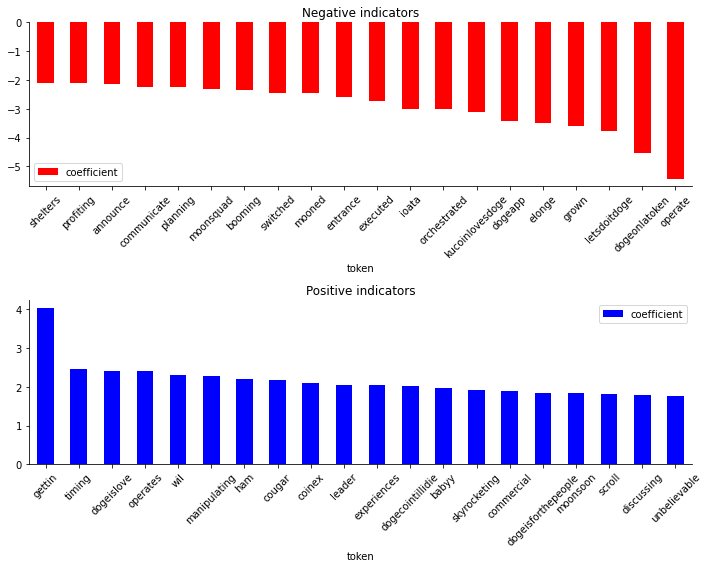

In [69]:
### Step 4. Plot top 20 words by sentiment

words = bagofwords.get_feature_names()
def plot_coefs(logreg, words):
    coef_df = pd.DataFrame({"coefficient": logreg.coef_[0], "token": words})
    coef_df = coef_df.sort_values("coefficient", ascending=False)

    fig, axs = plt.subplots(2, 1, figsize=(10, 8))

    # smallest coefficient -> tokens indicating negative sentiment 
    coef_df.tail(20).set_index("token").plot(kind="bar", rot=45, ax=axs[0], color="red")
    axs[0].set_title("Negative indicators")
 
    
    # largest coefficient -> tokens indicating positive sentiment 
    coef_df.head(20).set_index("token").plot(kind="bar", rot=45, ax=axs[1], color="blue")
    axs[1].set_title("Positive indicators")
    
    sns.despine()
    plt.tight_layout()
    plt.show()
    
plot_coefs(logreg, words)

In [70]:
X_train_transformed.shape

(129064, 36434)

In [72]:
### Step 5. Stemming and Lemmatization

# Using stemming to reduce words to the root word
# Using stopwords to remove common words that do not add to our analysis
# Using min_df to ignore tokens that do not appear in at least 5 documents
import nltk
stemmer = nltk.stem.PorterStemmer()
bagofwords = CountVectorizer(min_df=5, 
                             tokenizer = lambda x: [stemmer.stem(i) for i in x.split(' ')], # splitting the phrases by whitespace, stemming each word, defining our tokenizer custom
                             stop_words='english')
bagofwords.fit(X_train)

X_train_transformed = bagofwords.transform(X_train)
X_test_transformed = bagofwords.transform(X_test)

F:\Applications\lib\site-packages\sklearn\feature_extraction\text.py:383: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['abov', 'afterward', 'alon', 'alreadi', 'alway', 'ani', 'anoth', 'anyon', 'anyth', 'anywher', 'becam', 'becaus', 'becom', 'befor', 'besid', 'cri', 'describ', 'dure', 'els', 'elsewher', 'empti', 'everi', 'everyon', 'everyth', 'everywher', 'fifti', 'formerli', 'forti', 'ha', 'henc', 'hereaft', 'herebi', 'hi', 'howev', 'hundr', 'inde', 'latterli', 'mani', 'meanwhil', 'moreov', 'mostli', 'nobodi', 'noon', 'noth', 'nowher', 'onc', 'onli', 'otherwis', 'ourselv', 'perhap', 'pleas', 'seriou', 'sever', 'sinc', 'sincer', 'sixti', 'someon', 'someth', 'sometim', 'somewher', 'themselv', 'thenc', 'thereaft', 'therebi', 'therefor', 'thi', 'thu', 'togeth', 'twelv', 'twenti', 'veri', 'wa', 'whatev', 'whenc', 'whenev', 'wherea', 'whereaft', 'wherebi', 'wherev', 'whi', 'yourselv'] not in stop_words.
  warnings.warn(

In [73]:
# Fitting a model
logreg = LogisticRegression()
logreg.fit(X_train_transformed, y_train)

# Training and test score
print(f"Train score: {logreg.score(X_train_transformed, y_train)}")
print(f"Test score: {logreg.score(X_test_transformed, y_test)}")

Train score: 0.6959570445670366
Test score: 0.6715401422528009


F:\Applications\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


<a name="top20sampled"></a>

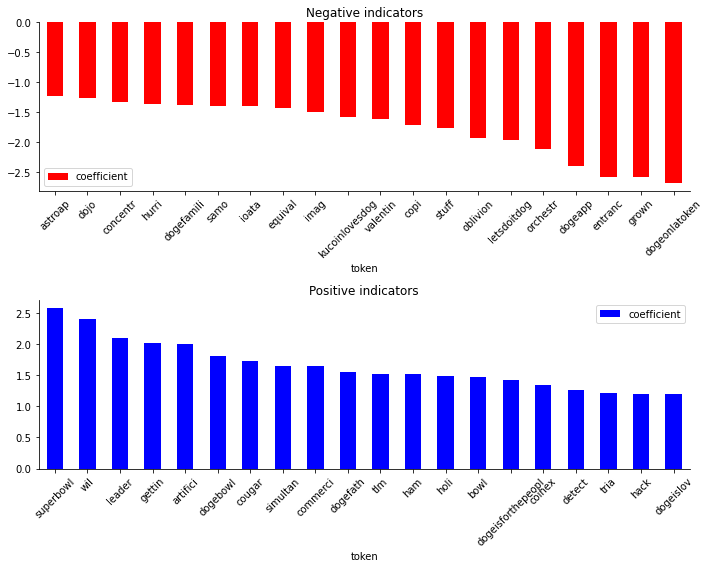

In [74]:
words = bagofwords.get_feature_names()
def plot_coefs(logreg, words):
    coef_df = pd.DataFrame({"coefficient": logreg.coef_[0], "token": words})
    coef_df = coef_df.sort_values("coefficient", ascending=False)

    fig, axs = plt.subplots(2, 1, figsize=(10, 8))

    # smallest coefficient -> tokens indicating negative sentiment 
    coef_df.tail(20).set_index("token").plot(kind="bar", rot=45, ax=axs[0], color="red")
    axs[0].set_title("Negative indicators")
 
    
    # largest coefficient -> tokens indicating positive sentiment 
    coef_df.head(20).set_index("token").plot(kind="bar", rot=45, ax=axs[1], color="blue")
    axs[1].set_title("Positive indicators")
    
    sns.despine()
    plt.tight_layout()
    plt.show()
    
plot_coefs(logreg, words)

<a name="full"></a>

### Use Full Dataset to Fit a Model to our Data and perform Sentiment Analysis, Full Dataset ~ 900K+ Rows, Logistic Regression most accurate model

1. Split dataset into train and test datasets
2. Tokenize both datasets for model fitting
3. Fit model and test for accuracy
4. Plot top 20 words by sentiment
5. Stemming & Lemmatization to test for a higher accuracy score
6. Re-plot top 20 words by sentiment
7. Perform further tokenization using NLTK for a potentially higher accuracy score
8. Perform further tokenization using TFiD for a potentially higher accuracy score

In [75]:
### Store simplified data in X and y
Z = dogesentiment['tweet']
v = dogesentiment['sentiment']

In [76]:
### Step 1. Train Test Split

Z_train, Z_test, v_train, v_test = train_test_split(Z, v, test_size=0.25, random_state=42)

In [131]:
Z_train.shape

(645321,)

In [78]:
### Step 2. Transform datasets into sparse matrices

# 1. Instantiate
bagofwords = CountVectorizer()

# 2. Fit
bagofwords.fit(Z_train)

# 3. Transform
Z_train_transformed = bagofwords.transform(Z_train)
Z_train_transformed

<645321x80986 sparse matrix of type '<class 'numpy.int64'>'
	with 9724801 stored elements in Compressed Sparse Row format>

In [79]:
Z_test_transformed = bagofwords.transform(Z_test)
Z_test_transformed

<215108x80986 sparse matrix of type '<class 'numpy.int64'>'
	with 3223734 stored elements in Compressed Sparse Row format>

In [80]:
### Step 3. Fit model and test for accuracy

# Fitting a model
logreg = LogisticRegression()
logreg.fit(Z_train_transformed, v_train)

# Training and test score
print(f"Train score: {logreg.score(Z_train_transformed, v_train)}")
print(f"Test score: {logreg.score(Z_test_transformed, v_test)}")

F:\Applications\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Train score: 0.7006141129763327
Test score: 0.6875244063447199


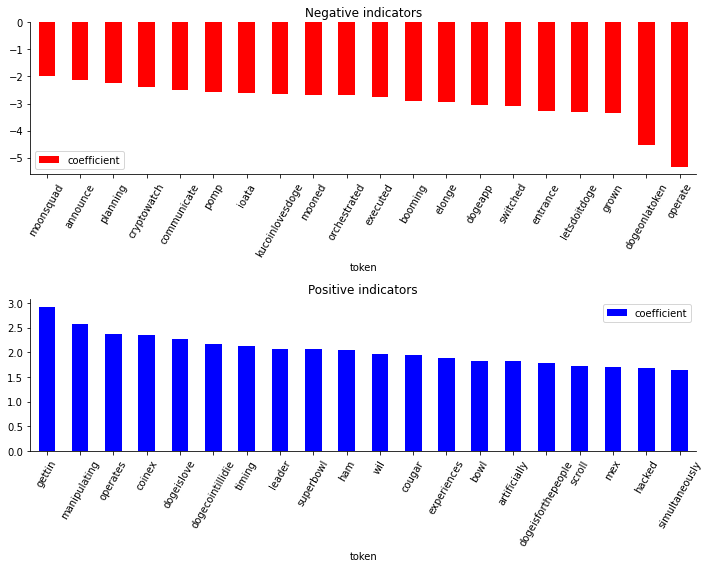

In [84]:
### Step 4. Plot top 20 words by sentiment

words = bagofwords.get_feature_names()
def plot_coefs(logreg, words):
    coef_df = pd.DataFrame({"coefficient": logreg.coef_[0], "token": words})
    coef_df = coef_df.sort_values("coefficient", ascending=False)

    fig, axs = plt.subplots(2, 1, figsize=(10, 8))

    # smallest coefficient -> tokens indicating negative sentiment 
    coef_df.tail(20).set_index("token").plot(kind="bar", rot=60, ax=axs[0], color="red")
    axs[0].set_title("Negative indicators")
 
    
    # largest coefficient -> tokens indicating positive sentiment 
    coef_df.head(20).set_index("token").plot(kind="bar", rot=60, ax=axs[1], color="blue")
    axs[1].set_title("Positive indicators")
    
    sns.despine()
    plt.tight_layout()
    plt.show()
    
plot_coefs(logreg, words)

In [100]:
### Step 5. Stemming & Lemmatization

# Using stemming to reduce words to the root word
# Using stopwords to remove common words that do not add to our analysis
# Using min_df to ignore tokens that do not appear in at least 100 documents

# import nltk
# stemmer = nltk.stem.PorterStemmer()
bagofwords = CountVectorizer(min_df=100, 
                             #tokenizer = lambda x: [stemmer.stem(i) for i in x.split(' ')], # tried using stemmer and our accuracy score fell along with our tokens
                                                                                             # not making any sense
                             stop_words='english')
bagofwords.fit(X_train)

Z_train_transformed = bagofwords.transform(Z_train)
Z_test_transformed = bagofwords.transform(Z_test)

In [101]:
# Fitting a model
logreg = LogisticRegression()
logreg.fit(Z_train_transformed, v_train)

# Training and test score
print(f"Train score: {logreg.score(Z_train_transformed, v_train)}")
print(f"Test score: {logreg.score(Z_test_transformed, v_test)}")

Train score: 0.6728000483480314
Test score: 0.6708862524871227


F:\Applications\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


<a name="top20full"></a>

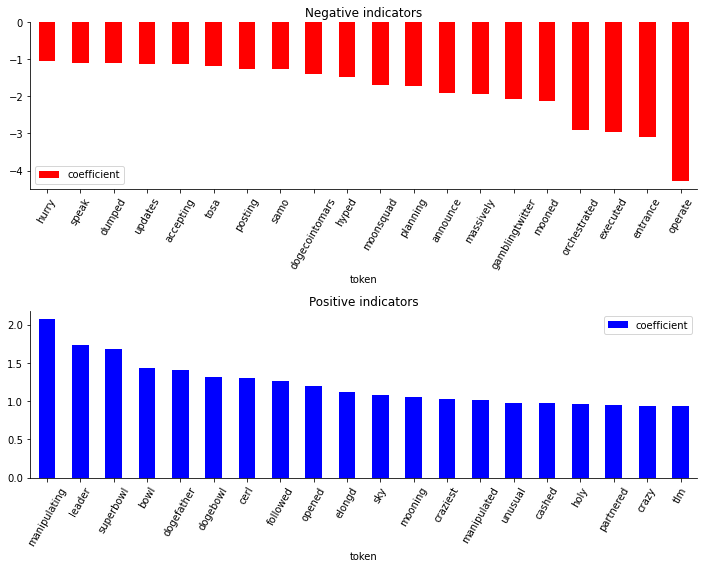

In [102]:
### Step 6. Re-plot words after stemming and lemmatization

words = bagofwords.get_feature_names()
def plot_coefs(logreg, words):
    coef_df = pd.DataFrame({"coefficient": logreg.coef_[0], "token": words})
    coef_df = coef_df.sort_values("coefficient", ascending=False)

    fig, axs = plt.subplots(2, 1, figsize=(10, 8))

    # smallest coefficient -> tokens indicating negative sentiment 
    coef_df.tail(20).set_index("token").plot(kind="bar", rot=60, ax=axs[0], color="red")
    axs[0].set_title("Negative indicators")
 
    
    # largest coefficient -> tokens indicating positive sentiment 
    coef_df.head(20).set_index("token").plot(kind="bar", rot=60, ax=axs[1], color="blue")
    axs[1].set_title("Positive indicators")
    
    sns.despine()
    plt.tight_layout()
    plt.show()
    
plot_coefs(logreg, words)

In [106]:
### Step 7. Perform further tokenization using NLTK

# import the nltk stopwords
nltk.download('stopwords')
from nltk.corpus import stopwords 

ENGLISH_STOP_WORDS = stopwords.words('english')

def my_tokenizer(sentence):

    # split sentence into words
    listofwords = sentence.split(' ')
    listofstemmed_words = []
    
    # remove stopwords and any tokens that are just empty strings
    for word in listofwords:
        if (not word in ENGLISH_STOP_WORDS) and (word!=''):
            # Stem words
            stemmed_word = stemmer.stem(word)
            listofstemmed_words.append(stemmed_word)

    return listofstemmed_words

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Admin\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [132]:
### Further custom tokenization utilizing n_gram = 2 for potential higher accuracy scores

bagofwords = CountVectorizer(min_df=100,
                             tokenizer=my_tokenizer,
                             ngram_range=(1, 2))
bagofwords.fit(Z_train)

Z_train_transformed = bagofwords.transform(Z_train)
Z_test_transformed = bagofwords.transform(Z_test)

Z_train_transformed.shape

F:\Applications\lib\site-packages\sklearn\feature_extraction\text.py:484: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn("The parameter 'token_pattern' will not be used"


(645321, 10466)

In [133]:
# Fitting a model
logreg = LogisticRegression()
logreg.fit(Z_train_transformed, v_train)

# Training and test score
print(f"Train score: {logreg.score(Z_train_transformed, v_train)}")
print(f"Test score: {logreg.score(Z_test_transformed, v_test)}")

Train score: 0.7109020162058882
Test score: 0.7012523941461963


F:\Applications\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


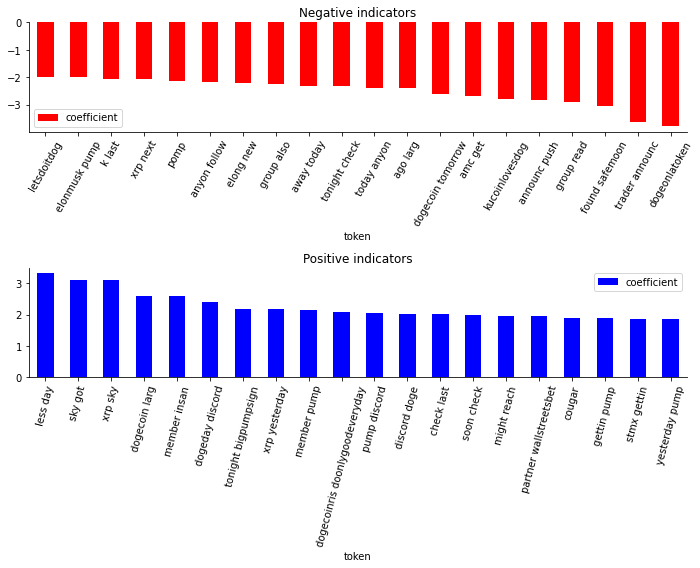

In [136]:
### Plot top 20 words by sentiment with two_grams

words = bagofwords.get_feature_names()
def plot_coefs(logreg, words):
    coef_df = pd.DataFrame({"coefficient": logreg.coef_[0], "token": words})
    coef_df = coef_df.sort_values("coefficient", ascending=False)

    fig, axs = plt.subplots(2, 1, figsize=(10, 8))

    # smallest coefficient -> tokens indicating negative sentiment 
    coef_df.tail(20).set_index("token").plot(kind="bar", rot=60, ax=axs[0], color="red")
    axs[0].set_title("Negative indicators")
 
    
    # largest coefficient -> tokens indicating positive sentiment 
    coef_df.head(20).set_index("token").plot(kind="bar", rot=75, ax=axs[1], color="blue")
    axs[1].set_title("Positive indicators")
    
    sns.despine()
    plt.tight_layout()
    plt.show()
    
plot_coefs(logreg, words)

In [137]:
### Step 8. Perform further tokenization using TFiD for a potentially higher accuracy score

from sklearn.feature_extraction.text import TfidfVectorizer

# using our custom tokenizer in TfidfVectorizer
tfidf = TfidfVectorizer(min_df=100,
                        tokenizer=my_tokenizer)
tfidf.fit(Z_train)

X_train_transformed = tfidf.transform(Z_train)
X_test_transformed = tfidf.transform(Z_test)

Z_train_transformed.shape

F:\Applications\lib\site-packages\sklearn\feature_extraction\text.py:484: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn("The parameter 'token_pattern' will not be used"


(645321, 10466)

In [138]:
# Fitting a model
logreg = LogisticRegression()
logreg.fit(Z_train_transformed, v_train)

# Training and test score
print(f"Train score: {logreg.score(Z_train_transformed, v_train)}")
print(f"Test score: {logreg.score(Z_test_transformed, v_test)}")

F:\Applications\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Train score: 0.7109020162058882
Test score: 0.7012523941461963


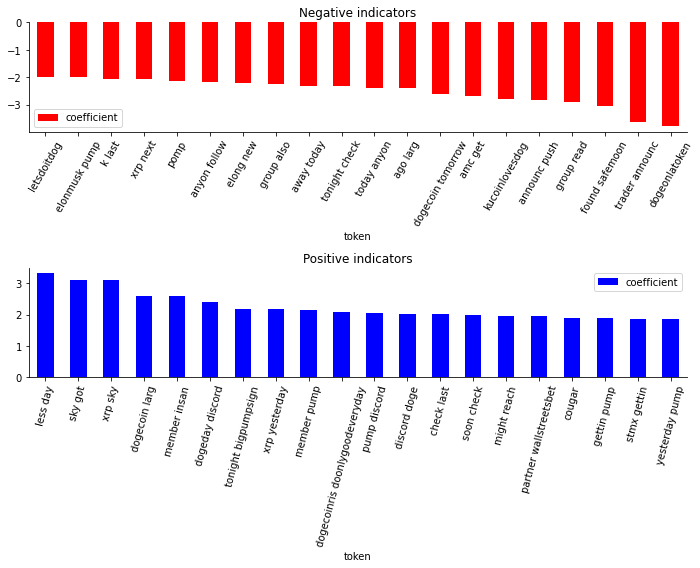

In [139]:
words = bagofwords.get_feature_names()
def plot_coefs(logreg, words):
    coef_df = pd.DataFrame({"coefficient": logreg.coef_[0], "token": words})
    coef_df = coef_df.sort_values("coefficient", ascending=False)

    fig, axs = plt.subplots(2, 1, figsize=(10, 8))

    # smallest coefficient -> tokens indicating negative sentiment 
    coef_df.tail(20).set_index("token").plot(kind="bar", rot=60, ax=axs[0], color="red")
    axs[0].set_title("Negative indicators")
 
    
    # largest coefficient -> tokens indicating positive sentiment 
    coef_df.head(20).set_index("token").plot(kind="bar", rot=75, ax=axs[1], color="blue")
    axs[1].set_title("Positive indicators")
    
    sns.despine()
    plt.tight_layout()
    plt.show()
    
plot_coefs(logreg, words)

<a name="further"></a>
# SVM MODELING ON SAMPLED DATA
1. Fit Model
2. Test Accuracy on Model

In [117]:
### Step 1. Fit Model 

from sklearn.svm import LinearSVC

SVM_model = LinearSVC(C=(10**10))
SVM_model.fit(X_train_transformed, y_train)

print(f"The TRAIN classification accuracy is: {SVM_model.score(X_train_transformed, y_train)}")

The TRAIN classification accuracy is: 0.7887172255625117


In [118]:
### Step 2. Test Model

from sklearn.svm import LinearSVC

print(f"The TEST classification accuracy is: {SVM_model.score(X_test_transformed, y_test)}")

The TEST classification accuracy is: 0.628329691785598


# SVM MODELING ON FULL DATASET
1. Fit Model
2. Test Accuracy on Model

In [119]:
### Step 1. Fit Model

from sklearn.svm import LinearSVC

SVM_model = LinearSVC(C=(10**10))
SVM_model.fit(Z_train_transformed, v_train)

print(f"The TRAIN classification accuracy is: {SVM_model.score(Z_train_transformed, v_train)}")

The TRAIN classification accuracy is: 0.7037939258136648


In [120]:
### Step 2. Test Model

from sklearn.svm import LinearSVC

print(f"The TEST classification accuracy is: {SVM_model.score(Z_test_transformed, v_test)}")

The TEST classification accuracy is: 0.5793229447533332


# DECISION TREE MODELING ON SAMPLED DATA
1. Fit Model
2. Test Accuracy on Model
3. Find Max Depth for optimal accuracy

In [122]:
### Step 1. Fit Model

# Decision Tree Model on sampled dogesentiment dataset, "dogesentimentsample"
from sklearn.tree import DecisionTreeClassifier

# Fit to the training data
DT_model = DecisionTreeClassifier()
DT_model.fit(X_train_transformed, y_train)

### Step 2. Test Model
print(f"The TRAIN classification accuracy is:  {DT_model.score(X_train_transformed,y_train)}")
print(f"The TEST classification accuracy is:  {DT_model.score(X_test_transformed,y_test)}")

The TRAIN classification accuracy is:  0.9411454782123597
The TEST classification accuracy is:  0.6588024731532705


In [124]:
### Step 3. Find most optimal max_depth

# X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.5, stratify=y)

depths = np.arange(1,31)
train_scores = []
test_scores = []

for depth in depths:
    
    # fit model 
    DT_model = DecisionTreeClassifier(max_depth = depth)
    DT_model.fit(X_train_transformed,y_train)
    
    # score on train and test
    train_scores.append(DT_model.score(X_train_transformed, y_train))
    test_scores.append(DT_model.score(X_test_transformed, y_test))
    

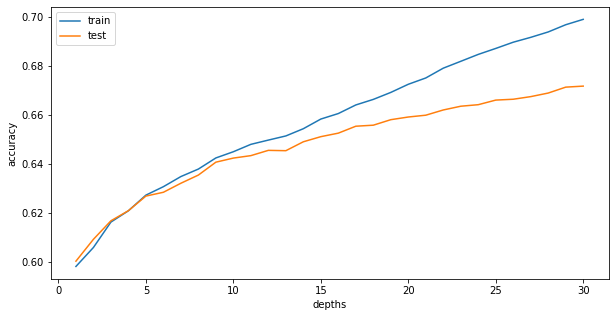

In [125]:
### Plot the accuracy scores and max_depth correlations

plt.figure(figsize=(10,5))
plt.plot(depths, train_scores,label='train')
plt.plot(depths, test_scores, label='test')
plt.xlabel('depths')
plt.ylabel('accuracy')
plt.legend()
plt.show()

In [126]:
print(f'best depth: {depths[np.argmax(test_scores)]}')

print(max(test_scores))

best depth: 30
0.67179582539166


# DECISION TREE MODELING ON FULL DATASET
1. Fit Model
2. Test Accuracy on Model
3. Find Max Depth for optimal accuracy

In [127]:
### Step 1. Fit Model

# Fit to the training data
DT_model = DecisionTreeClassifier()
DT_model.fit(Z_train_transformed, v_train)

### Step 2. Test Model
print(f"The TRAIN classification accuracy is:  {DT_model.score(Z_train_transformed,v_train)}")
print(f"The TEST classification accuracy is:  {DT_model.score(Z_test_transformed,v_test)}")

The TRAIN classification accuracy is:  0.9332874646881164
The TEST classification accuracy is:  0.6819597597485914


In [128]:
### Step 3. Find most optimal max_depth

depths = np.arange(1,31)
train_scores = []
test_scores = []

for depth in depths:
    
    # fit model 
    DT_model = DecisionTreeClassifier(max_depth = depth)
    DT_model.fit(Z_train_transformed,v_train)
    
    # score on train and test
    train_scores.append(DT_model.score(Z_train_transformed, v_train))
    test_scores.append(DT_model.score(Z_test_transformed, v_test))

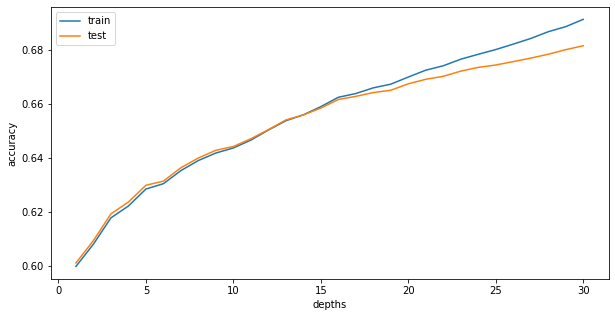

In [129]:
### Plot the accuracy scores and max_depth correlations

plt.figure(figsize=(10,5))
plt.plot(depths, train_scores,label='train')
plt.plot(depths, test_scores, label='test')
plt.xlabel('depths')
plt.ylabel('accuracy')
plt.legend()
plt.show()

In [130]:
print(f'best depth: {depths[np.argmax(test_scores)]}')

print(max(test_scores))

best depth: 30
0.6814437398888


**My overall conclusion is that while there is some correlation between the price movement of Dogecoin and twitter, there doesn't seem to be any causal correlation between them.**


Thank you for viewing my source code. If you would like to connect or take this project further, please feel free to reach out. Special shoutout to Brainstation Data Science bootcamp for all I've learned over the past 12 weeks. Great program, highly recommended, for multiple disciplines.   


`Temitayo Ade-Oshifogun, Data Scientist`